In [1]:
import sys

from sklearn.datasets import make_moons
import numpy as np

#For plotting and animation
%matplotlib inline
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# --- Plotting Style and Setup ---
# Use a clean, publication-quality style
plt.style.use('seaborn-v0_8-paper')
# Update parameters for larger, more readable text
plt.rcParams.update({
    'font.size': 14,
    'axes.labelsize': 14,
    'axes.titlesize': 16,
    'xtick.labelsize': 12,
    'ytick.labelsize': 12,
    'legend.fontsize': 12,
})


sys.path.append('../../src')

In [ ]:
# Generate the two moons dataset 
X, y = make_moons(n_samples=500, noise=0.2, random_state=42)
X_min, X_max = X.min(axis=0) - 0.5, X.max(axis=0) + 0.5
X.shape, y.shape

from layers import InputLayer
X_animation = InputLayer(6,[-2.5, 2.5])(X)

Animation size has reached 21020821 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


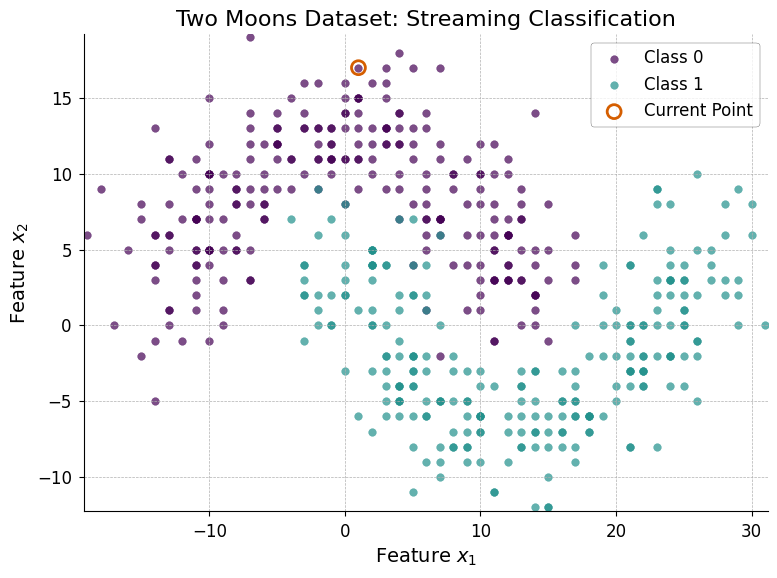

In [4]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from sklearn.datasets import make_moons
from IPython.display import HTML


# --- Create Figure and Axes ---
fig, ax = plt.subplots(figsize=(8, 6)) # A good aspect ratio for presentations

# Set a clear title and labels
ax.set_title("Two Moons Dataset: Streaming Classification")
ax.set_xlabel(r"Feature $x_1$")
ax.set_ylabel(r"Feature $x_2$")

# Define a professional, colorblind-friendly color palette
# These colors are from the 'viridis' colormap
colors = ['#440154', '#21918c'] 

# --- Prepare Scatter Plots for Animation ---
# Add alpha for a softer look, especially with overlapping points
scat0 = ax.scatter([], [], c=colors[0], label="Class 0", alpha=0.7)
scat1 = ax.scatter([], [], c=colors[1], label="Class 1", alpha=0.7)

# Make the 'current' point stand out more
current = ax.scatter([], [], s=100, facecolors='none', edgecolors='#d55e00', linewidths=2, label="Current Point")

# --- Fine-tune Axes and Legend ---
# Add some padding to the axis limits
x_min, x_max = X_animation[:, 0].min() - 0.2, X_animation[:, 0].max() + 0.2
y_min, y_max = X_animation[:, 1].min() - 0.2, X_animation[:, 1].max() + 0.2
ax.set_xlim(x_min, x_max)
ax.set_ylim(y_min, y_max)

# Remove the top and right spines to reduce clutter
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# Create a more elegant legend
legend = ax.legend(loc="upper right", frameon=True, fancybox=True, framealpha=0.8)
legend.get_frame().set_edgecolor('black')

# Add a light grid for better readability
ax.grid(True, which='both', linestyle='--', linewidth=0.5)

# Ensure tight layout
fig.tight_layout()

# --- Animation Functions (Unchanged Logic) ---
def init():
    """Initializes the animation with empty data."""
    empty = np.empty((0, 2))
    scat0.set_offsets(empty)
    scat1.set_offsets(empty)
    current.set_offsets(empty)
    return scat0, scat1, current

def update(i):
    """Updates the plot for each frame of the animation."""
    # Update points for class 0
    pts_0 = X_animation[:i+1][y[:i+1] == 0]
    scat0.set_offsets(pts_0)
    
    # Update points for class 1
    pts_1 = X_animation[:i+1][y[:i+1] == 1]
    scat1.set_offsets(pts_1)
    
    # Highlight the current point
    current.set_offsets(X_animation[i])
    return scat0, scat1, current

# --- Create and Display Animation ---
ani = FuncAnimation(fig, update, frames=len(X_animation), init_func=init, interval=40, blit=True, repeat=False)
HTML(ani.to_jshtml())

In [5]:
#Now develop the ECLAIR model
from eclair import Eclair

config = {
    'layer_sizes': [2, 2, 1],
    'layer_bitwidths': [6, 6, 6],
    'learning_rate': 0.1,
    'input_range': [-2.5, 2.5]
}

model = Eclair(config)

#Create a figure to plot the data points and the model's decision boundary
# fig, ax = plt.subplots(figsize=(8, 6))

#Stream single data points into the model
for i in range(len(X)):

    #Update the model with the current data point
    model(X[i])

    #Plot the decision boundary
    


TypeError: InputLayer.__init__() takes 3 positional arguments but 4 were given